In [0]:
#convert data from csv to dataframe
path="---"
df_events = spark.read.format("csv").option("header", "true").load(path + "athlete_events.csv")
df_regions = spark.read.format("csv").option("header", "true").load(path + "noc_regions.csv")
#creating tables
df_events.write.mode("overwrite").saveAsTable("eventt")
df_regions.write.mode("overwrite").saveAsTable("region")

In [0]:
%sql
-- When importing data NA wasnt readed as NULL
UPDATE eventt
SET Age=NULL
WHERE Age='NA';

UPDATE eventt
SET Name=NULL
WHERE Name='NA';

UPDATE eventt
SET Sex=NULL
WHERE Sex='NA';

UPDATE eventt
SET Age=NULL
WHERE Age='NA';

UPDATE eventt
SET Height=NULL
WHERE Height='NA';

UPDATE eventt
SET Weight=NULL
WHERE Weight='NA';

UPDATE eventt
SET Team=NULL
WHERE Team='NA';

UPDATE eventt
SET NOC=NULL
WHERE NOC='NA';

UPDATE eventt
SET Games=NULL
WHERE Games='NA';

UPDATE eventt
SET Year=NULL
WHERE Year='NA';

UPDATE eventt
SET Season=NULL
WHERE Season='NA';

UPDATE eventt
SET City=NULL
WHERE City='NA';

UPDATE eventt
SET Sport=NULL
WHERE Sport='NA';

UPDATE eventt
SET Event=NULL
WHERE Event='NA';

UPDATE eventt
SET Medal=NULL
WHERE Medal='NA';

num_affected_rows
231333


In [0]:
%fs rm -r dbfs:/user/hive/warehouse/TABLA

In [0]:
%sql
--Creating new table to change data types (park SQL doesn't directly 
--support altering the data type of an existing column in a table)
CREATE TABLE IF NOT EXISTS sports_events (
  ID INT,
  Name STRING,
  Sex STRING,
  Age FLOAT,
  Height FLOAT,
  Weight FLOAT,
  Team STRING,
  NOC STRING,
  Games STRING,
  Year INT,         
  Season STRING,
  City STRING,
  Sport STRING,
  Event STRING,
  Medal STRING
);

In [0]:
%sql
INSERT INTO sports_events
SELECT
  ID,
  Name,
  Sex,
  CAST(Age AS FLOAT),     -- Convert Age column to FLOAT
  CAST(Height AS FLOAT),  -- Convert Height column to FLOAT
  CAST(Weight AS FLOAT),  -- Convert Weight column to FLOAT
  Team,
  NOC,
  Games,
  CAST(Year AS INT), -- Convert Year column to INT
  Season,
  City,
  Sport,
  Event,
  Medal
FROM eventt;

num_affected_rows,num_inserted_rows
271116,271116


In [0]:
%sql
DROP TABLE IF EXISTS eventt;

In [0]:
%sql
UPDATE sports_events
SET Name=TRIM('"' FROM Name);

num_affected_rows
271116


Let's see how the data looks now

In [0]:
%sql
SELECT * FROM sports_events

ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,null
2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,null
3,Gunnar Nielsen Aaby,M,24.0,null,null,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,null
4,Edgar Lindenau Aabye,M,34.0,null,null,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 1000 metres,null
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 1000 metres,null
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 1000 metres,null


In [0]:
%sql
SELECT 
    MAX(Age) max_age, 
    MIN(Age) min_age, 
    ROUND(AVG(Age),2) avg_age
FROM sports_events

max_age,min_age,avg_age
97.0,10.0,25.56


In [0]:
%sql 
SELECT Games, COUNT(ID) participants
FROM sports_events 
GROUP BY Games 
ORDER BY COUNT(ID) desc 

Games,participants
2000 Summer,13821
1996 Summer,13780
2016 Summer,13688
2008 Summer,13602
2004 Summer,13443
1992 Summer,12977
2012 Summer,12920
1988 Summer,12037
1972 Summer,10304
1984 Summer,9454


Databricks visualization. Run in Databricks to view.

In [0]:
%sql
SELECT Name, COUNT(ID) GoldMedals
FROM sports_events 
WHERE Medal='Gold'
GROUP BY Name
ORDER BY COUNT(ID) DESC

Name,GoldMedals
Michael Fred Phelps II,23
"Raymond Clarence """"Ray"""" Ewry",10
Paavo Johannes Nurmi,9
Mark Andrew Spitz,9
Larysa Semenivna Latynina (Diriy-),9
"Frederick Carlton """"Carl"""" Lewis",9
Usain St. Leo Bolt,8
"Matthew Nicholas """"Matt"""" Biondi",8
Ole Einar Bjrndalen,8
Birgit Fischer-Schmidt,8


In [0]:
%sql
SELECT 
  COALESCE(b.Team,gs._Team) Team, 
  COALESCE(Gold_Medals,0)  GoldMedals, 
  COALESCE(Silver_Medals,0) SilverMedals, 
  COALESCE(Bronze_Medals,0) BronzeMedals,
  GoldMedals+SilverMedals+BronzeMedals Total
FROM
(
  SELECT Team, COUNT(ID) Bronze_Medals
  FROM sports_events
  WHERE Medal='Bronze'
  GROUP BY Team
  ORDER BY COUNT(ID) DESC  
) AS b 
FULL OUTER JOIN
(
  SELECT 
    COALESCE(g.Team,S.Team) _Team, 
    COALESCE(GoldMedals,0) Gold_Medals , 
    COALESCE(SilverMedals,0) Silver_Medals, 
    Gold_Medals+Silver_Medals Total
  FROM
  (
    SELECT Team, COUNT(ID) GoldMedals
    FROM sports_events
    WHERE Medal='Gold'
    GROUP BY Team
    ORDER BY COUNT(ID) DESC
  ) g 
  FULL OUTER JOIN
  (
    SELECT Team, COUNT(ID) SilverMedals
    FROM sports_events
    WHERE Medal='Silver'
    GROUP BY Team
    ORDER BY COUNT(ID) DESC
  ) s 
  ON s.Team=g.Team     
) gs 
ON gs._Team=b.Team


Team,GoldMedals,SilverMedals,BronzeMedals,Total
"""Large boat Central Naval Prep School """"Poros""""-1""",17,0,0,17
"""Life boat naval ship """"Spetsai""""-1""",0,7,0,7
"""Marinai della nave da guerra """"Varese""""""",7,0,17,24
"""Phalainis ton Thorichtou """"Hydra""""-2""",0,17,7,24
A North American Team,0,0,4,4
Afghanistan,0,0,2,2
Algeria,5,4,8,17
Ali-Baba II,0,0,5,5
Amateur Athletic Association,5,0,0,5
Amstel Amsterdam,0,0,4,4


In [0]:
%sql 
SELECT * FROM sports_events

ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal
1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,null
2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,null
3,Gunnar Nielsen Aaby,M,24.0,null,null,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,null
4,Edgar Lindenau Aabye,M,34.0,null,null,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 1000 metres,null
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 1000 metres,null
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 500 metres,null
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 1000 metres,null


In [0]:
%sql 
SELECT 
  COALESCE(winter.Year, summer.Year) year,
  COALESCE(WinterParticipants,0) Winter_Participant,
  COALESCE(SummerParticipants,0) Summer_Participant,
  Winter_Participant + Summer_Participant Total
FROM
(
  SELECT Year, COUNT(ID) WinterParticipants
  FROM sports_events 
  WHERE Season='Winter'
  GROUP BY Year
  ORDER BY COUNT(ID) desc 
) winter
FULL OUTER JOIN
(
  SELECT Year, COUNT(ID) SummerParticipants
  FROM sports_events 
  WHERE Season='Summer'
  GROUP BY Year
  ORDER BY COUNT(ID) desc   
) summer
ON winter.Year=summer.Year


year,Winter_Participant,Summer_Participant,Total
1896,0,380,380
1900,0,1936,1936
1904,0,1301,1301
1906,0,1733,1733
1908,0,3101,3101
1912,0,4040,4040
1920,0,4292,4292
1924,460,5233,5693
1928,582,4992,5574
1932,352,2969,3321


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

In [0]:
%sql
SELECT Name, NOC, COUNT(ID) GoldMedals
FROM sports_events 
WHERE Medal='Gold'
GROUP BY Name, NOC
ORDER BY COUNT(ID) DESC 
LIMIT 20

Name,NOC,GoldMedals
Michael Fred Phelps II,USA,23
"Raymond Clarence """"Ray"""" Ewry",USA,10
Paavo Johannes Nurmi,FIN,9
Mark Andrew Spitz,USA,9
Larysa Semenivna Latynina (Diriy-),URS,9
"Frederick Carlton """"Carl"""" Lewis",USA,9
"Matthew Nicholas """"Matt"""" Biondi",USA,8
Ole Einar Bjrndalen,NOR,8
Usain St. Leo Bolt,JAM,8
"Jennifer Elisabeth """"Jenny"""" Thompson (-Cumpelik)",USA,8


In [0]:
%sql
SELECT 
  NOC, 
  COUNT(ID) GoldMedals,
  ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS CountryPosition
FROM sports_events 
WHERE Medal='Gold'
GROUP BY NOC
ORDER BY GoldMedals DESC

NOC,GoldMedals,CountryPosition
USA,2638,1
URS,1082,2
GER,745,3
GBR,678,4
ITA,575,5
FRA,501,6
SWE,479,7
CAN,463,8
HUN,432,9
GDR,397,10


In [0]:
%sql
--In the top 20 competitors with the most Gold Medals the average country position in total gold
--medals is 7.8, this means that the top competitors with the most gold medals are from the
--countries which got more gold medals over all.
SELECT AVG(CountryPosition) AvgPos_Top20
FROM
(
  SELECT 
    Top20.Name,
    Top20.GoldMedals,
    Top20.NOC,
    Pos.CountryPosition
  FROM 
  (
    SELECT Name, NOC, COUNT(ID) GoldMedals
    FROM sports_events 
    WHERE Medal='Gold'
    GROUP BY Name, NOC
    ORDER BY COUNT(ID) DESC 
    LIMIT 20
  ) Top20
  LEFT OUTER JOIN 
  (
    SELECT 
      NOC, 
      COUNT(ID) GoldMedals,
      ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS CountryPosition
    FROM sports_events 
    WHERE Medal='Gold'
    GROUP BY NOC
    ORDER BY GoldMedals DESC
  ) Pos 
  ON Top20.NOC=Pos.NOC
) 


AvgPos_Top20
7.8


In [0]:
%sql
SELECT SUM(Winners) AS `Not top sport total winners`
FROM
(
  SELECT
    Sport,
    COUNT(ID) Winners
  FROM sports_events
  WHERE NOC='USA' AND Medal='Gold'
  GROUP BY Sport
) 
WHERE
  Sport!='Swimming' AND
  Sport!='Athletics' AND
  Sport!='Basketball' AND
  Sport!='Rowing'

Not top sport total winners
980


In [0]:
%sql
SELECT 
  SUM(Winners) `Top sports total winners`
FROM
(
  SELECT 
    Sport,
    COUNT(ID) Winners
  FROM sports_events
  WHERE NOC='USA' AND Medal='Gold'
  GROUP BY Sport
) 
WHERE
  Sport='Swimming' OR
  Sport='Athletics' OR
  Sport='Basketball' OR
  Sport='Rowing'

Top sports total winners
1658


1658 gold medals were achieved by Swimming, Athletics, Basketball, Rowing

980 gold medals were achieved without those 4 disciplines (the others are 40)

Therefore, 62% of the gold medals were achieved by the 9% of the medal-winning disciplines of USA

In [0]:
%sql
SELECT 
  NOC, 
  COUNT(ID) GoldMedals,
  ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS CountryPosition
FROM sports_events 
WHERE Medal='Gold'
GROUP BY NOC
ORDER BY GoldMedals DESC

NOC,GoldMedals,CountryPosition
USA,2638,1
URS,1082,2
GER,745,3
GBR,678,4
ITA,575,5
FRA,501,6
SWE,479,7
CAN,463,8
HUN,432,9
GDR,397,10


In [0]:
%sql
SELECT 
  COUNT(Top100.PersonalPosition) AS total_top100,
  Pos.CountryPosition
FROM 
(
  SELECT 
    ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS PersonalPosition,
    Name, 
    NOC, 
    COUNT(ID) GoldMedals
  FROM sports_events 
  WHERE Medal='Gold'
  GROUP BY Name, NOC
  LIMIT 100
) Top100
LEFT OUTER JOIN 
(
  SELECT 
    NOC, 
    COUNT(ID) GoldMedals,
    ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS CountryPosition
  FROM sports_events 
  WHERE Medal='Gold'
  GROUP BY NOC
  ORDER BY GoldMedals DESC
) Pos 
ON Top100.NOC=Pos.NOC
GROUP BY Pos.CountryPosition
ORDER BY total_top100 DESC

total_top100,CountryPosition
32,1
10,2
7,4
6,9
6,3
5,12
5,16
4,13
3,18
3,5


Databricks visualization. Run in Databricks to view.

The amount of top-ranked personal winners grows as the position of the team. This means top 1 team tend to have more competitors in the top100 than the top 2 team and so

In [0]:
%sql

SELECT 
  COUNT(ID) MedalWinners,
  Year
FROM sports_events
WHERE 
  Medal IS NOT NULL AND 
  Season='Summer' AND 
  Year>1936
GROUP BY Year

MedalWinners,Year
897,1952
893,1956
1582,1988
1057,1968
2001,2004
1842,1996
911,1960
1941,2012
2023,2016
1384,1980


Databricks visualization. Run in Databricks to view.

Number of medal winners increments by year. The reason of this is clearly that the amounts of competitors and sports also grew.

In [0]:
from pyspark.sql import SparkSession

# Creating a SparkSession
spark = SparkSession.builder \
    .appName("Convert SQL table to Python lists") \
    .getOrCreate()

# Reading the SQL table into a DataFrame
df = spark.sql("""
 SELECT 
    COUNT(Top100.PersonalPosition) AS total_top100,
    CountryPosition
  FROM 
  (
    SELECT 
      ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS PersonalPosition,
      Name, 
      NOC, 
      COUNT(ID) GoldMedals
    FROM sports_events 
    WHERE Medal='Gold'
    GROUP BY Name, NOC
    LIMIT 100
  ) Top100
  LEFT OUTER JOIN 
  (
    SELECT 
      NOC, 
      COUNT(ID) GoldMedals,
      ROW_NUMBER() OVER (ORDER BY COUNT(ID) DESC) AS CountryPosition
    FROM sports_events 
    WHERE Medal='Gold'
    GROUP BY NOC
    ORDER BY GoldMedals DESC
  ) Pos 
  ON Top100.NOC=Pos.NOC
  GROUP BY Pos.CountryPosition
  ORDER BY CountryPosition ASC             
""")



In [0]:
# Converting the DataFrame columns into Python lists
total_top100 = df.select("total_top100").rdd.flatMap(lambda x: x).collect()
country_position = df.select("CountryPosition").rdd.flatMap(lambda x: x).collect()

In [0]:
import numpy as np
import matplotlib.pyplot as plt

In [0]:
#Fill mising country position values
coefs=np.polyfit(country_position,total_top100,2)
resize_country_position=np.arange(1, 43, 1, dtype=int)
resize_total_top100=np.abs(np.polyval(coefs, resize_country_position))
for x in range(len(total_top100)):
    resize_total_top100[x-1]=total_top100[x-1]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


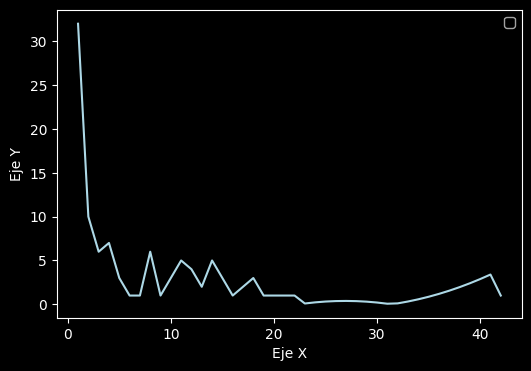

In [0]:
plt.style.use("dark_background")
fig, ax = plt.subplots(figsize=(6,4))
plt.plot(resize_country_position, resize_total_top100,color="lightblue")
ax.set_xlabel("Eje X")
ax.set_ylabel("Eje Y")
ax.legend() 
plt.show()

In [0]:
%sql
--Not medal winners
SELECT 
  ROUND(AVG(CASE WHEN Sex='M' THEN Height END),2) MaleAvgHeight, 
  ROUND(AVG(CASE WHEN Sex='F' THEN Height END),2) FemaleAvgHeight
FROM(
  SELECT 
    ID,
    Height,
    Sex,
    SUM(MedalBinary)
  FROM(
    SELECT 
      ID, 
      Height,
      Sex,
      CASE WHEN Medal IS NOT NULL THEN 1 ELSE 0 END MedalBinary
    FROM sports_events
    WHERE Year>2000
  )
  GROUP BY ID, Height, Sex
  HAVING SUM(MedalBinary)=0
)


MaleAvgHeight,FemaleAvgHeight
181.21,169.05


In [0]:
%sql
--Medal winners
SELECT 
  ROUND(AVG(CASE WHEN Sex='M' THEN Height END),2) MaleAvgHeight, 
  ROUND(AVG(CASE WHEN Sex='F' THEN Height END),2) FemaleAvgHeight
FROM(
  SELECT 
    ID,
    Height,
    Sex,
    SUM(MedalBinary)
  FROM(
    SELECT 
      ID, 
      Height,
      Sex,
      CASE WHEN Medal IS NOT NULL THEN 1 ELSE 0 END MedalBinary
    FROM sports_events
    WHERE Year>2000
  )
  GROUP BY ID, Height, Sex
  HAVING SUM(MedalBinary)>0
)

MaleAvgHeight,FemaleAvgHeight
183.18,171.07


New Metric

In [0]:
%sql
SELECT 
  *,
  CASE WHEN Medal IS NOT NULL THEN 1 ELSE 0 END MedalBinary
FROM sports_events


ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,MedalBinary
1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,null,0
2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,null,0
3,Gunnar Nielsen Aaby,M,24.0,null,null,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,null,0
4,Edgar Lindenau Aabye,M,34.0,null,null,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,1
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 1000 metres,null,0
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 1000 metres,null,0
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 1000 metres,null,0


In [0]:
%sql
SELECT 
  *,
  CASE 
    WHEN NOC IN('USA', 'URS', 'GER', 'GBR','ITA')
    THEN 1 ELSE 0 
  END Top5Binary
FROM sports_events

ID,Name,Sex,Age,Height,Weight,Team,NOC,Games,Year,Season,City,Sport,Event,Medal,Top5Binary
1,A Dijiang,M,24.0,180.0,80.0,China,CHN,1992 Summer,1992,Summer,Barcelona,Basketball,Basketball Men's Basketball,null,0
2,A Lamusi,M,23.0,170.0,60.0,China,CHN,2012 Summer,2012,Summer,London,Judo,Judo Men's Extra-Lightweight,null,0
3,Gunnar Nielsen Aaby,M,24.0,null,null,Denmark,DEN,1920 Summer,1920,Summer,Antwerpen,Football,Football Men's Football,null,0
4,Edgar Lindenau Aabye,M,34.0,null,null,Denmark/Sweden,DEN,1900 Summer,1900,Summer,Paris,Tug-Of-War,Tug-Of-War Men's Tug-Of-War,Gold,0
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,21.0,185.0,82.0,Netherlands,NED,1988 Winter,1988,Winter,Calgary,Speed Skating,Speed Skating Women's 1000 metres,null,0
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,25.0,185.0,82.0,Netherlands,NED,1992 Winter,1992,Winter,Albertville,Speed Skating,Speed Skating Women's 1000 metres,null,0
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 500 metres,null,0
5,Christine Jacoba Aaftink,F,27.0,185.0,82.0,Netherlands,NED,1994 Winter,1994,Winter,Lillehammer,Speed Skating,Speed Skating Women's 1000 metres,null,0
